<a href="https://colab.research.google.com/github/vansh123321/Projects/blob/master/Data_Visualization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib as plt
from plotly.offline import iplot, init_notebook_mode
import plotly.offline as pyo
import plotly.graph_objs as go
pyo.init_notebook_mode()
import plotly.express as px
import warnings
warnings.filterwarnings("ignore")
#init_notebook_mode(connected=False)

cp = pd.read_csv("../input/factors-affecting-campus-placement/Placement_Data_Full_Class.csv")
df1 = pd.read_csv("/kaggle/input/house-prices-advanced-regression-techniques/train.csv")
age = pd.read_csv("../input/titanic/train.csv")
sales = pd.read_csv("/kaggle/input/competitive-data-science-predict-future-sales/items.csv")
cp = cp.fillna(0)
iris = pd.read_csv('/kaggle/input/iris-flower-dataset/IRIS.csv')
wine_reviews = pd.read_csv('/kaggle/input/winemagdata130k/winemag-data-130k-v2.csv', index_col=0)

# Line Plot

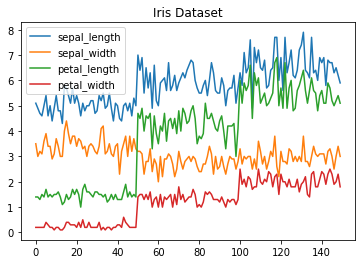

In [ ]:
columns = iris.columns.drop(['species'])
x_data = range(0, iris.shape[0])
fig, ax = plt.subplots()
for column in columns:
    ax.plot(x_data, iris[column], label=column)
ax.set_title('Iris Dataset')
ax.legend()

# Histogram Plot

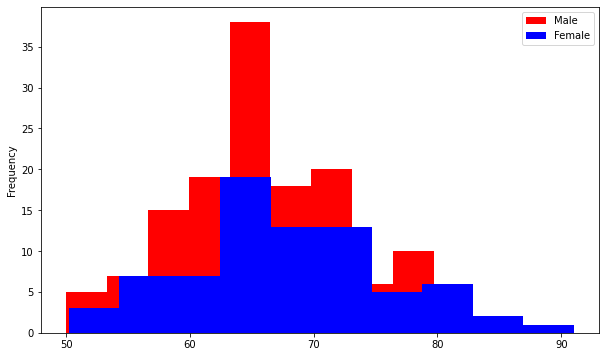

In [ ]:
from matplotlib import pyplot as plt
m = cp[cp['gender']=="M"]
f = cp[cp['gender']=="F"]
plt.figure(figsize=(10,6))
ax = m['degree_p'].plot.hist(bins=10 ,color="red")
ax = f['degree_p'].plot.hist(bins=10,color="blue")
plt.legend(['Male', 'Female'])

# Density plot

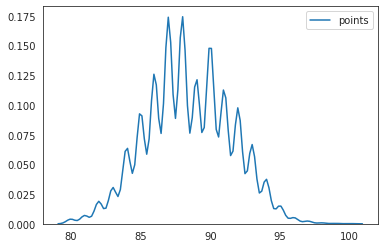

In [ ]:
sns.kdeplot(wine_reviews['points'])

# Dist Plot

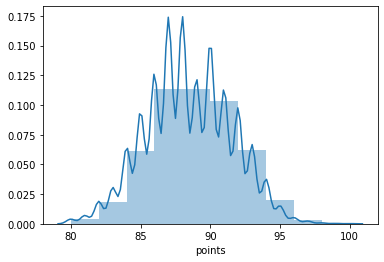

In [ ]:
sns.distplot(wine_reviews['points'], bins=10, kde=True)

# Bar Plot

In [ ]:
import plotly.express as px
grgs = cp.groupby(["gender","specialisation"])[["salary"]].mean().reset_index()
fig = px.bar(grgs[['gender', 'salary','specialisation']].sort_values('salary', ascending=False), 
             y="salary", x="gender", color='specialisation', 
             log_y=True, template='ggplot2')
fig.show()


# Count Plot

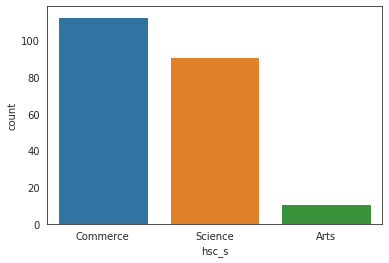

In [ ]:
ax = sns.countplot(x="hsc_s", data=cp)


# Pie Chart

In [ ]:
grdsp = cp.groupby(["degree_t"])[["degree_p"]].mean().reset_index()

fig = px.pie(grdsp,
             values="degree_p",
             names="degree_t",
             template="seaborn")
fig.update_traces(rotation=45, pull=0.03, textinfo="percent+label")
fig.show()

# Box Plot

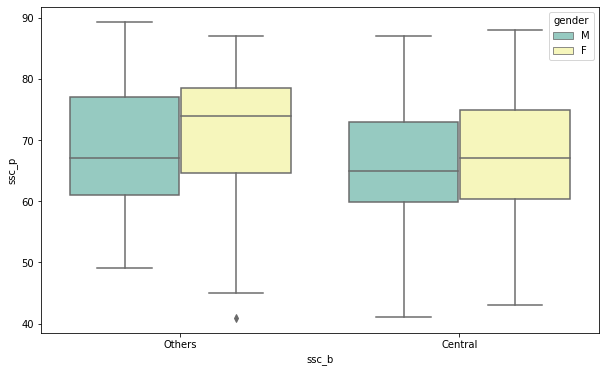

In [ ]:
plt.figure(figsize=(10,6))
ax = sns.boxplot(x="ssc_b", y="ssc_p", hue="gender",
                 data=cp, palette="Set3")

# Notched Box Plot

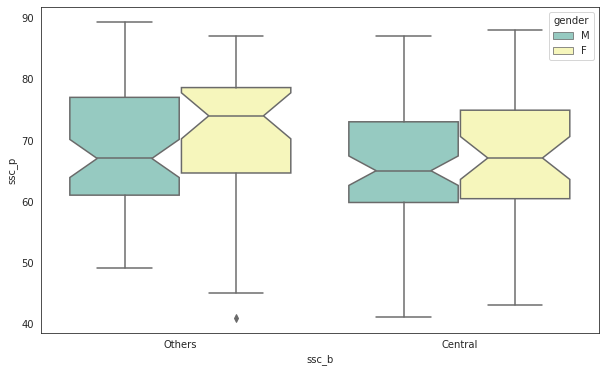

In [ ]:

plt.figure(figsize=(10,6))
ax = sns.boxplot(x="ssc_b", y="ssc_p", hue="gender",
                 data=cp,palette="Set3",notch=True)


# Boxen Plot

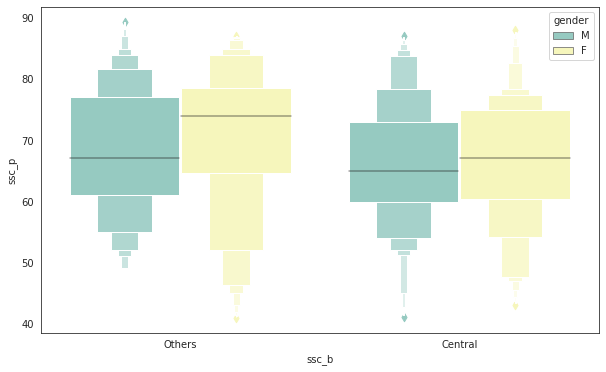

In [ ]:

plt.figure(figsize=(10,6))
ax = sns.boxenplot(x="ssc_b", y="ssc_p", hue="gender",
                 data=cp,palette="Set3")


# Joint Plot

**Marginal Histogram**

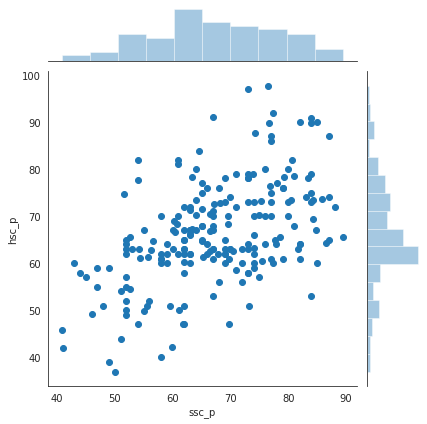

In [ ]:
sns.jointplot(x="ssc_p", y="hsc_p", data=cp)

**Adding Marginal regression**

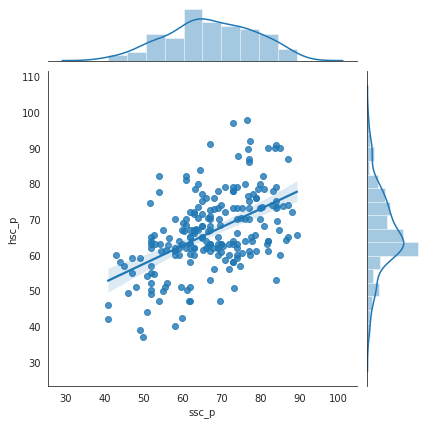

In [ ]:
sns.jointplot(x="ssc_p", y="hsc_p", data=cp, kind="reg")

**Adding Hex**

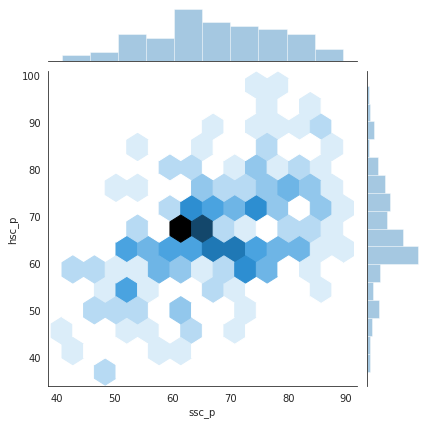

In [ ]:
sns.jointplot(x="ssc_p", y="hsc_p", data=cp, kind="hex")

**Add kedplot**

In [ ]:
sns.jointplot(x="ssc_p", y="hsc_p", data=cp, kind="kde")

# Swarm Plot

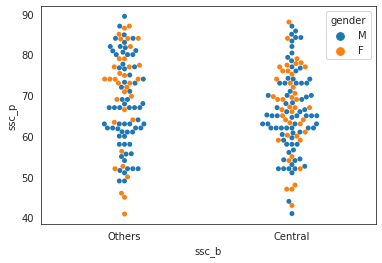

In [ ]:
ax = sns.swarmplot(x="ssc_b", y="ssc_p", hue="gender",data=cp)

# Strip Plot

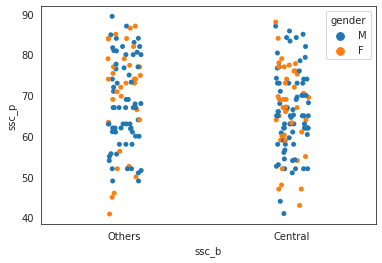

In [ ]:
ax = sns.stripplot(x="ssc_b", y="ssc_p", hue="gender",data=cp)

# Cat Plot

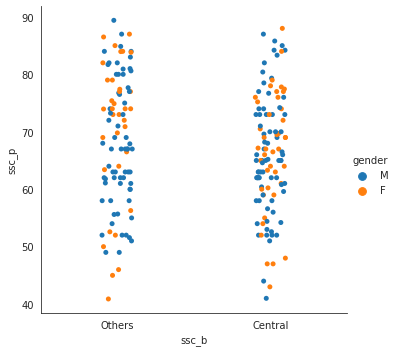

In [ ]:
ax = sns.catplot(x="ssc_b", y="ssc_p", hue="gender",data=cp)

# Heat Map

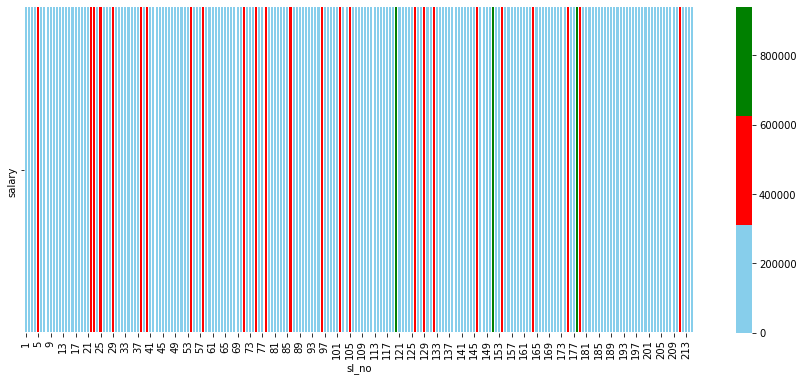

In [ ]:
import seaborn as sns
plt.figure(figsize=(15,6))
h=pd.pivot_table(cp,columns='sl_no',values=["salary"])
sns.heatmap(h,cmap=['skyblue','red','green'],linewidths=0.05)


# Faceting

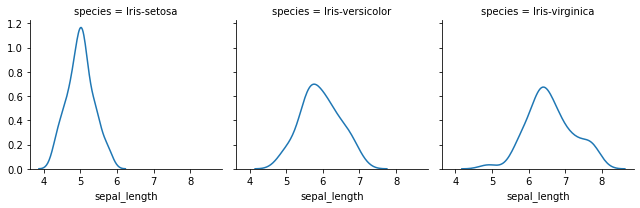

In [ ]:
g = sns.FacetGrid(iris, col='species')
g = g.map(sns.kdeplot, 'sepal_length')

# Pairplot

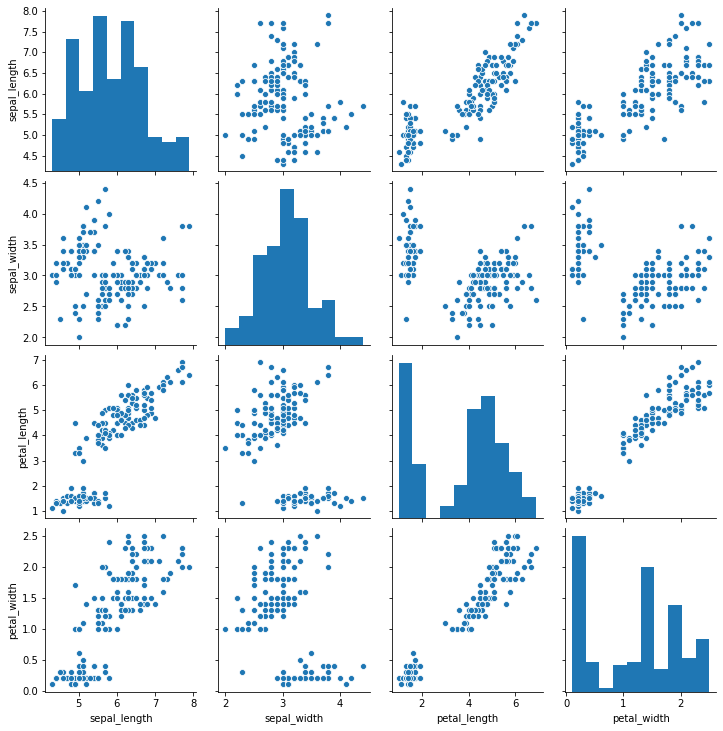

In [ ]:
sns.pairplot(iris)

# Tree Plot 

In [ ]:
covid_India_cases = pd.read_csv('../input/covid19-in-india/covid_19_india.csv')
covid_India_cases.rename(columns={'State/UnionTerritory': 'State', 'Cured': 'Recovered', 'Confirmed': 'Confirmed'}, inplace=True)

statewise_cases = pd.DataFrame(covid_India_cases.groupby(['State'])['Confirmed', 'Deaths', 'Recovered'].max().reset_index())
statewise_cases["Country"] = "India" # in order to have a single root node
fig = px.treemap(statewise_cases, path=['Country','State'], values='Confirmed',
                  color='Confirmed', hover_data=['State'],
                  color_continuous_scale='Rainbow')
fig.show()

# Sunburst Plot

In [ ]:
sales = sales.tail(20)
fig = px.sunburst(sales, path=["item_category_id",'item_id'],
                  color='item_category_id', hover_data=['item_id'],
                  color_continuous_scale='thermal')
fig.show()


# Scatter Plot

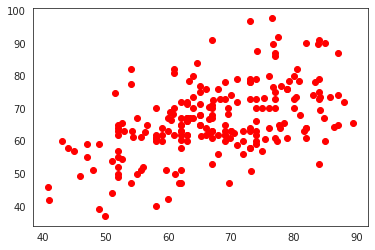

In [ ]:
plt.scatter(cp.ssc_p,cp.hsc_p,color='red')


# Rel Plot

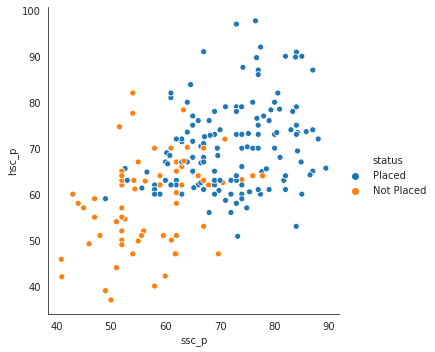

In [ ]:
g = sns.relplot(x="ssc_p", y="hsc_p", hue="status", data=cp)

# Resid Plot

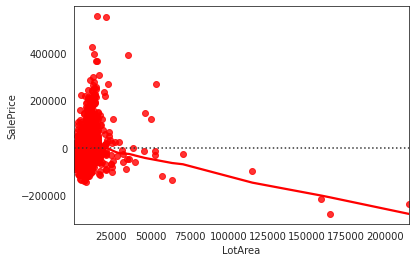

In [ ]:
sns.residplot(df1.LotArea, df1.SalePrice, lowess=True, color="red")

# LM Plot

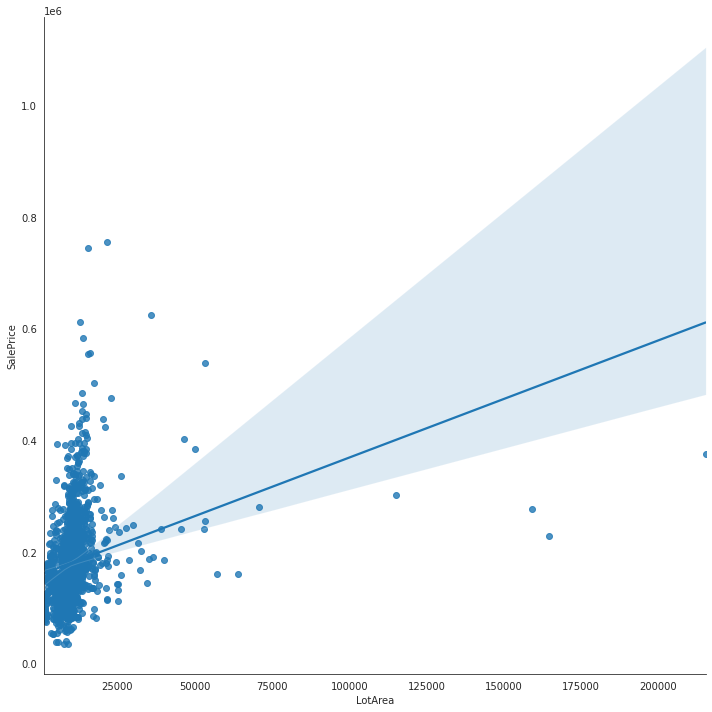

In [ ]:
sns.lmplot(x = 'LotArea' ,y= 'SalePrice', data=df1, size=10)

# Bubble Plot

In [ ]:
pip install bubbly

  Created wheel for bubbly: filename=bubbly-1.0.2-py3-none-any.whl size=5428 sha256=6b38759fd809747512888ea7b5659440b0f653cd38289826f6c9a86d50ffa4a5
  Stored in directory: /root/.cache/pip/wheels/f3/a2/b4/e8c5235bb3da5f686d87429eac448bead93e17c7ac0d7cfc2d
Successfully built bubbly
Note: you may need to restart the kernel to use updated packages.


In [ ]:
pip install chart-studio

     |████████████████████████████████| 64 kB 1.6 MB/s eta 0:00:011
Note: you may need to restart the kernel to use updated packages.


In [ ]:
m = pd.read_csv("../input/global-hospital-beds-capacity-for-covid19/hospital_beds_USA_v1.csv")
from bubbly.bubbly import bubbleplot 
from plotly.offline import iplot
import chart_studio.plotly as py


figure = bubbleplot(dataset=m, x_column='beds', y_column='population', 
    bubble_column='state', size_column='beds', color_column='type', 
    x_logscale=True, scale_bubble=2, height=350)

iplot(figure)

# Calender Plot

In [ ]:
pip install calmap

Note: you may need to restart the kernel to use updated packages.


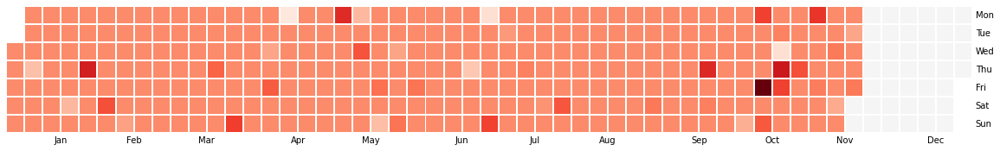

In [ ]:
import calmap
import numpy as np
f = plt.figure(figsize=(20,10))
all_days = pd.date_range('1/1/2019', periods=700, freq='D')
days = np.random.choice(all_days, 100)
events = pd.Series(np.random.randn(len(days)), index=days)
calmap.yearplot(events, year=2020)

# Violin Plot

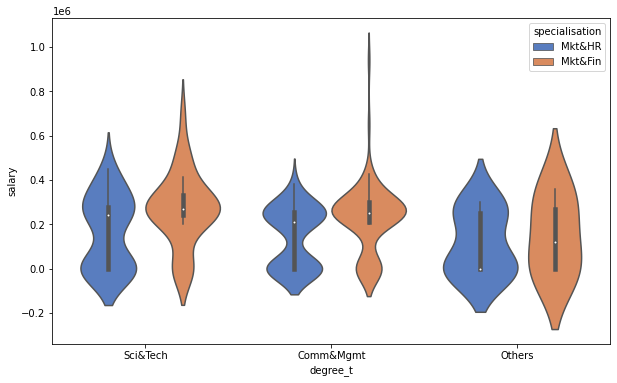

In [ ]:
plt.figure(figsize=(10,6))
ax = sns.violinplot(x="degree_t", y="salary", hue="specialisation",
                    data=cp, palette="muted")

# Spit Violin

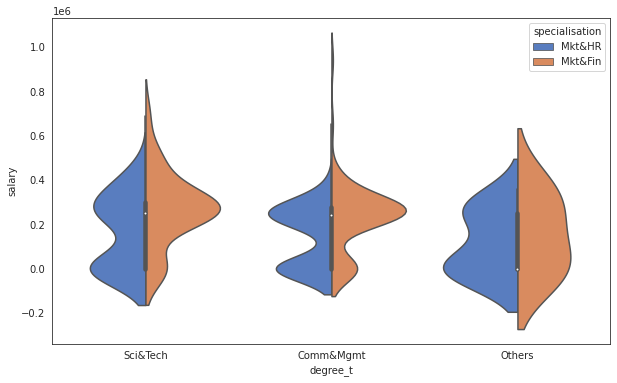

In [ ]:
plt.figure(figsize=(10,6))
ax = sns.violinplot(x="degree_t", y="salary", hue="specialisation",
                    data=cp, palette="muted",split=True)

# Area Plot

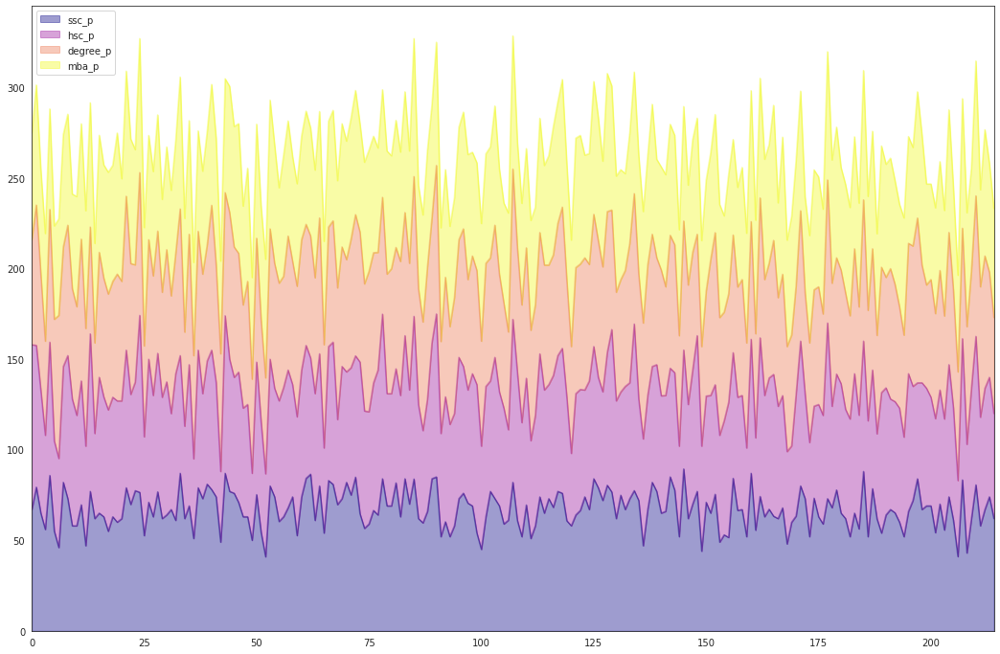

In [ ]:
cp.plot.area(y=['ssc_p','hsc_p','degree_p','mba_p'],alpha=0.4,figsize=(18, 12), cmap = 'plasma')

# Cluster Plot

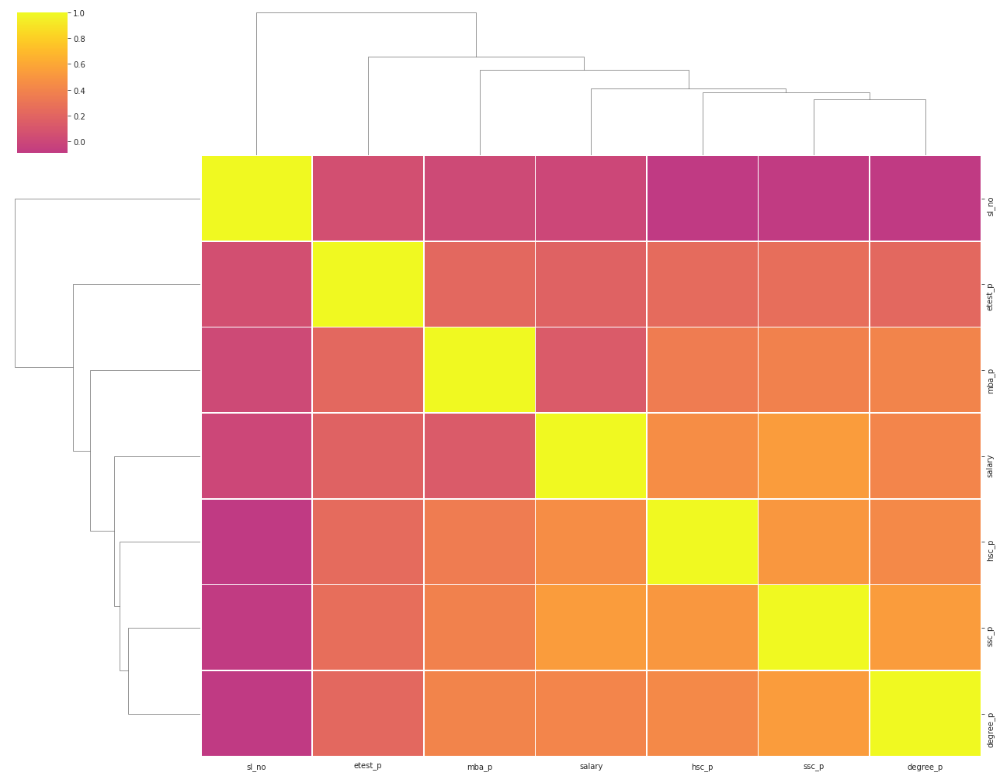

In [ ]:
sns.clustermap(cp.corr(), center=0, cmap="plasma",
               linewidths=.75, figsize=(18, 14))

# Folium Map

In [ ]:
m = pd.read_csv("../input/global-hospital-beds-capacity-for-covid19/hospital_beds_USA_v1.csv")

import folium
map = folium.Map(location=[37.0902,-95.7129 ], zoom_start=4,tiles='cartodbpositron')

for lat, lon,state,type in zip(m['lat'], m['lng'],m['state'],m['type']):
    folium.CircleMarker([lat, lon],
                        radius=5,
                        color='red',
                      popup =(
                    'State: ' + str(state) + '<br>'),

                        fill_color='red',
                        fill_opacity=0.7 ).add_to(map)
map

# Choropleth

In [ ]:
cases = pd.read_csv("../input/novel-corona-virus-2019-dataset/covid_19_data.csv")
grp = cases.groupby(['ObservationDate', 'Country/Region'])['Confirmed', 'Deaths', 'Recovered'].max()
grp = grp.reset_index()
grp['Date'] = pd.to_datetime(grp['ObservationDate'])
grp['Date'] = grp['Date'].dt.strftime('%m/%d/%Y')
grp['Active'] = grp['Confirmed'] - grp['Recovered'] - grp['Deaths']
grp['Country'] =  grp['Country/Region']

fig = px.choropleth(grp, locations="Country", locationmode='country names', 
                     color="Confirmed", hover_name="Country/Region",hover_data = [grp.Recovered,grp.Deaths,grp.Active],projection="orthographic",
                     animation_frame="Date",width=800, height=500,
                     color_continuous_scale='Reds',
                     range_color=[1000,50000],

                     title='World Map of Coronavirus')

fig.update(layout_coloraxis_showscale=True)
fig.show()

In [ ]:
pyo.init_notebook_mode()
fig = px.choropleth(m, locations=m["state"],       

 color=m["beds"],
                    locationmode="USA-states",
                    scope="usa",
                    color_continuous_scale='Reds',
                   )

fig.show()



# Rose Plot

In [ ]:
import plotly.express as px
df = px.data.wind()
fig = px.bar_polar(df, r="frequency", theta="direction",
                   color="strength", template="plotly_dark",
                   color_discrete_sequence= px.colors.sequential.Plasma_r)
fig.show()